In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
pd.set_option('display.max_columns', None)      # To view all expanded columns of dataframe
np.random.seed(42)  # for reproducibility

In [3]:
file_path1 = open("C:\\Users\\darsh\\vscodeProjects\\vscodeProjectQuickTest\\CareFacilityStaffingInsights\\Data\\PBJ_Daily_Nurse_Staffing_Q1_2024.csv")
df1 = pd.read_csv(file_path1)

C:\Users\darsh\AppData\Local\Temp\ipykernel_12736\3101490337.py:2: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  df1 = pd.read_csv(file_path1)


In [4]:
# df1.describe()        # To check nonnull values of data
# df1.shape               # (1330966, 33)

# Updated datetype of Workdate col from int to datetime
df1['WorkDate'] = pd.to_datetime(df1['WorkDate'], format='%Y%m%d')    
df1['WorkDay'] = pd.to_datetime(df1['WorkDate']).dt.strftime('%A')

In [5]:
df1.head(2)

,PROVNUM,PROVNAME,CITY,STATE,COUNTY_NAME,COUNTY_FIPS,CY_Qtr,WorkDate,MDScensus,Hrs_RNDON,Hrs_RNDON_emp,Hrs_RNDON_ctr,Hrs_RNadmin,Hrs_RNadmin_emp,Hrs_RNadmin_ctr,Hrs_RN,Hrs_RN_emp,Hrs_RN_ctr,Hrs_LPNadmin,Hrs_LPNadmin_emp,Hrs_LPNadmin_ctr,Hrs_LPN,Hrs_LPN_emp,Hrs_LPN_ctr,Hrs_CNA,Hrs_CNA_emp,Hrs_CNA_ctr,Hrs_NAtrn,Hrs_NAtrn_emp,Hrs_NAtrn_ctr,Hrs_MedAide,Hrs_MedAide_emp,Hrs_MedAide_ctr,WorkDay
0,15009,"BURNS NURSING HOME, INC.",RUSSELLVILLE,AL,Franklin,59,2024Q1,2024-01-01,50,8.0,8.0,0.0,8.00,8.00,0.0,40.07,40.07,0.0,0.0,0.0,0.0,18.16,18.16,0.0,156.34,156.34,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Monday
1,15009,"BURNS NURSING HOME, INC.",RUSSELLVILLE,AL,Franklin,59,2024Q1,2024-01-02,49,8.0,8.0,0.0,18.24,18.24,0.0,58.89,58.89,0.0,0.0,0.0,0.0,22.96,22.96,0.0,149.40,149.40,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Tuesday


In [6]:
# Finding Count of MedicareProvider facilities in each state
df3 = df1.copy()
df3.drop(columns=['COUNTY_FIPS',
       'CY_Qtr', 'WorkDate', 'MDScensus', 'Hrs_RNDON', 'Hrs_RNDON_emp',
       'Hrs_RNDON_ctr', 'Hrs_RNadmin', 'Hrs_RNadmin_emp', 'Hrs_RNadmin_ctr',
       'Hrs_RN', 'Hrs_RN_emp', 'Hrs_RN_ctr', 'Hrs_LPNadmin',
       'Hrs_LPNadmin_emp', 'Hrs_LPNadmin_ctr', 'Hrs_LPN', 'Hrs_LPN_emp',
       'Hrs_LPN_ctr', 'Hrs_CNA', 'Hrs_CNA_emp', 'Hrs_CNA_ctr', 'Hrs_NAtrn',
       'Hrs_NAtrn_emp', 'Hrs_NAtrn_ctr', 'Hrs_MedAide', 'Hrs_MedAide_emp',
       'Hrs_MedAide_ctr', 'WorkDay'], inplace=True)
df3.drop_duplicates(inplace=True)
# df3.shape            # (14658, 5)
s_provnum_count_in_state = df3.groupby('STATE').agg({'PROVNUM':'size'}).loc[:,'PROVNUM'].sort_values(ascending=False)
s_provnum_count_in_state.head(3)

STATE
TX    1166
CA    1143
OH     918
Name: PROVNUM, dtype: int64

In [7]:
# Learning the others cols of data
# (df1.loc[:,'COUNTY_FIPS'].nunique())            # 287
# (df1.loc[:,'COUNTY_NAME'].nunique())            # 1671

# s1_state = df1.loc[:,'STATE'].unique()                  # state count
# s1_state.value_counts()
# s1_state = pd.Series(s1_state.tolist())

# s1_provname = (df1.loc[:,'PROVNAME'].unique())
# s1_provname_series = pd.Series(s1_provname.tolist())
# s1_provname_series[s1_provname_series.str.contains('CLI',  regex=True)]           # Searching if Provider name contains 'CLI'

In [8]:
# To check the missing values
# empty_data = df1[df1.isna().any(axis=1)]
# print('\nThis is the missing data\n', empty_data)                 # no missing values

In [9]:
# Created column to get Total nurse staffing hours
df1['TotalHours'] = df1[['Hrs_RNDON', 'Hrs_RNadmin', 'Hrs_RN', 'Hrs_LPNadmin', 'Hrs_LPN', 'Hrs_CNA', 'Hrs_NAtrn', 'Hrs_MedAide']].sum(axis=1)
df1['TotalHours_ctr'] = df1[['Hrs_RNDON_ctr', 'Hrs_RNadmin_ctr', 'Hrs_RN_ctr', 'Hrs_LPNadmin_ctr', 'Hrs_LPN_ctr', 'Hrs_CNA_ctr', 'Hrs_NAtrn_ctr', 'Hrs_MedAide_ctr']].sum(axis=1)
df1['TotalHours_emp'] = df1[['Hrs_RNDON_emp', 'Hrs_RNadmin_emp', 'Hrs_RN_emp', 'Hrs_LPNadmin_emp', 'Hrs_LPN_emp', 'Hrs_CNA_emp', 'Hrs_NAtrn_emp', 'Hrs_MedAide_emp']].sum(axis=1)

#df1.Total_Nurse_Staffing_Hours

In [10]:
# Summation function testing
# df1.loc[:,'TotalHours'].iat[2]      # np.float64(245.97000000000003)
# df1.loc[:,['Hrs_RNDON', 'Hrs_RNadmin', 'Hrs_RN', 'Hrs_LPNadmin', 'Hrs_LPN', 'Hrs_CNA', 'Hrs_NAtrn', 'Hrs_MedAide']].iloc[2,:].sum()         # np.float64(245.97)

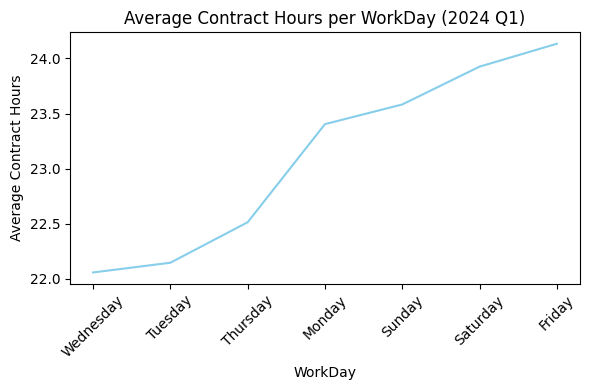

In [11]:
# Total Hours Contract per WorkDay
avg_total_ctr_hours_weekDay = df1.groupby('WorkDay')['TotalHours_ctr'].mean()
avg_total_ctr_hours_weekDay.sort_values(inplace=True)

plt.figure(figsize=(6, 4))
avg_total_ctr_hours_weekDay.plot(kind='line', color='skyblue')
plt.title('Average Contract Hours per WorkDay (2024 Q1)')
plt.xlabel('WorkDay')
plt.ylabel('Average Contract Hours')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [12]:
avg_ctr_hours_DaysGroup1_MonSunSatFri = (df1[df1['WorkDay'].isin(['Monday','Sunday','Saturday','Friday'])].groupby('WorkDay')['TotalHours_ctr'].mean()).mean()
avg_ctr_hours_DaysGroup2_WedTueThur = (df1[~df1['WorkDay'].isin(['Monday','Sunday','Saturday','Friday'])].groupby('WorkDay')['TotalHours_ctr'].mean()).mean()
print('avg_total_ctr_hours_DaysGroup1_MonSunSatFri:',avg_ctr_hours_DaysGroup1_MonSunSatFri,'\navg_total_ctr_hours_DaysGroup2_WedTueThur :', avg_ctr_hours_DaysGroup2_WedTueThur)
print(f'% of DaysGroup1_MonSunSatFri has more hours than DaysGroup2_WedTueThur :', round((((avg_ctr_hours_DaysGroup1_MonSunSatFri-avg_ctr_hours_DaysGroup2_WedTueThur)/avg_ctr_hours_DaysGroup2_WedTueThur) *100 ),2))

avg_total_ctr_hours_DaysGroup1_MonSunSatFri: 23.761231013789985 
avg_total_ctr_hours_DaysGroup2_WedTueThur : 22.23762982675741
% of DaysGroup1_MonSunSatFri has more hours than DaysGroup2_WedTueThur : 6.85


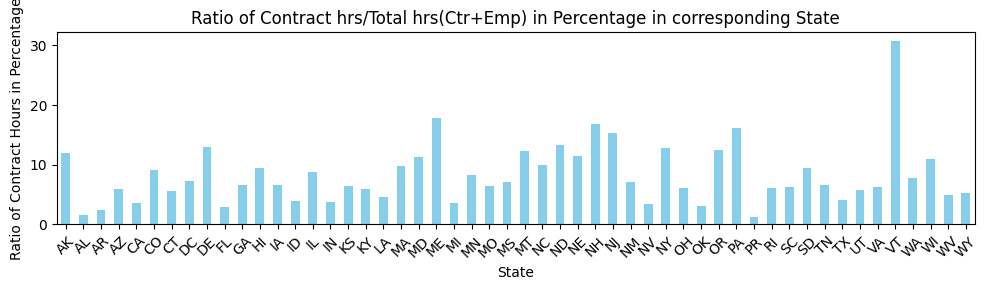

In [13]:
# Ratio of Contract hrs/Total hrs(Ctr+Emp) in Percentag in corresponding State 
total_hours_ctr_state = df1.groupby('STATE')['TotalHours_ctr'].sum()
total_hours_state = df1.groupby('STATE')['TotalHours'].sum()

ratio_ctr_hours_state = (total_hours_ctr_state/total_hours_state)*100

plt.figure(figsize=(10, 3))
ratio_ctr_hours_state.plot(kind='bar', color='skyblue')
# plt.title('Ratio of Contract Hours per State wrt employee(2024 Q1)')
plt.title('Ratio of Contract hrs/Total hrs(Ctr+Emp) in Percentage in corresponding State')
plt.xlabel('State')
plt.ylabel('Ratio of Contract Hours in Percentage')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

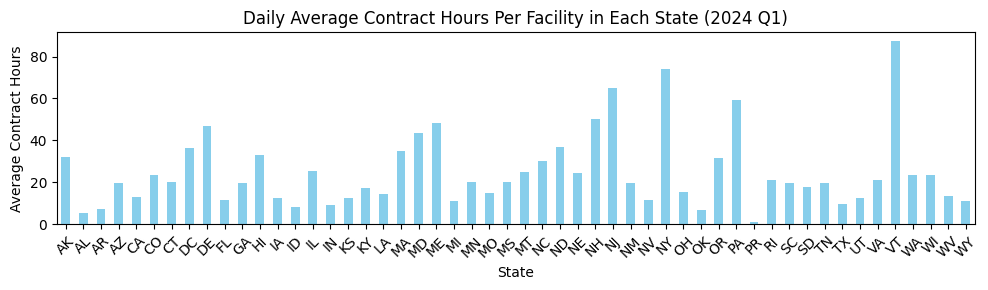

In [14]:
# Daily Average hours_ctr Per State
avg_hours_ctr_state = df1.groupby('STATE')['TotalHours_ctr'].mean()

plt.figure(figsize=(10, 3))
avg_hours_ctr_state.plot(kind='bar', color='skyblue')
plt.title('Daily Average Contract Hours Per Facility in Each State (2024 Q1)')
plt.xlabel('State')
plt.ylabel('Average Contract Hours')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [15]:
avg_hours_ctr_state.sort_values(ascending=False).head(5)

STATE
VT    87.169722
NY    73.859501
NJ    64.856851
PA    59.121611
NH    50.153822
Name: TotalHours_ctr, dtype: float64

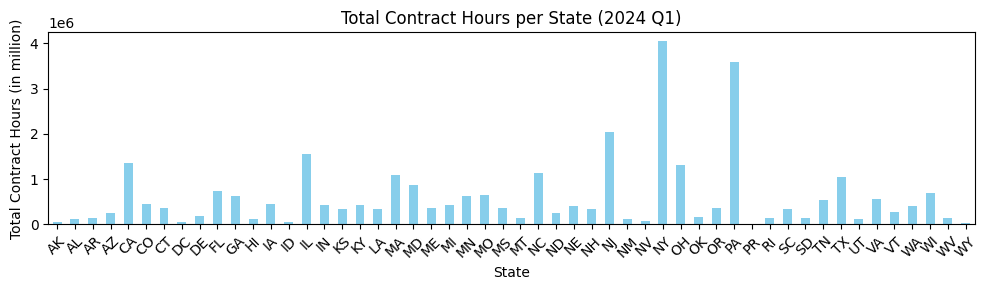

Top 20 States with Total Contract Hours:


STATE
NY    4039449.99
PA    3577744.31
NJ    2036180.84
IL    1557327.83
CA    1346552.77
OH    1304113.78
NC    1126111.32
MA    1090336.45
TX    1037825.88
MD     870030.27
FL     742218.49
WI     699262.13
MO     652555.27
GA     631519.83
MN     621091.52
VA     550142.38
TN     536555.63
IA     449290.14
CO     446458.82
IN     426527.80
Name: TotalHours_ctr, dtype: float64

In [16]:
# Total hours_ctr per State
total_hours_ctr_state = df1.groupby('STATE')['TotalHours_ctr'].sum()

plt.figure(figsize=(10, 3))
total_hours_ctr_state.plot(kind='bar', color='skyblue')
plt.title('Total Contract Hours per State (2024 Q1)')
plt.xlabel('State')
plt.ylabel('Total Contract Hours (in million)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
print('Top 20 States with Total Contract Hours:')
(total_hours_ctr_state).sort_values(ascending=False).head(20)


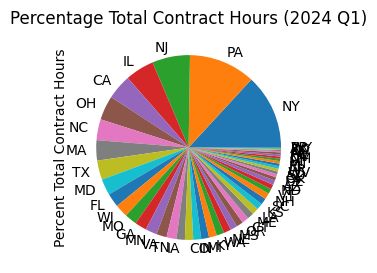

Top 5 states:


STATE
NY    13.133729
PA    11.632555
NJ     6.620368
IL     5.063442
CA     4.378135
Name: Percent Total Contract Hours, dtype: float64

Top 10 states share: 40.83 % 
Top 20 states share: 77.19 %


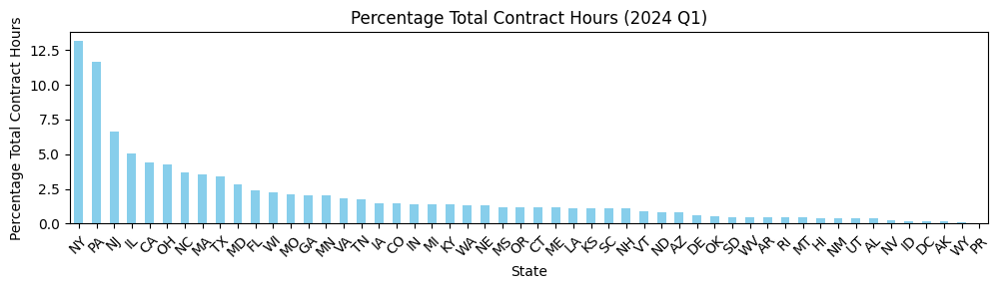

In [17]:
# Percentage Total hours_ctr 
total = total_hours_ctr_state.sum()
percent = ((total_hours_ctr_state/total)*100)

# make the pie chart
percent.name ='Percent Total Contract Hours'
percent.sort_values(ascending=False,inplace=True)
percent.plot(kind='pie', subplots=True, figsize=(3,3))
plt.title('Percentage Total Contract Hours (2024 Q1)')
# show the plot
plt.show()

# percent
print('Top 5 states:')
display(percent.head(5))

print(f'Top 10 states share:',round(percent.head(5).sum(),2),'\b %',
      '\nTop 20 states share:', round(percent.head(20).sum(),2),f'\b %')

# make the bar plot
plt.figure(figsize=(10, 3))
percent.plot(kind='bar', color='skyblue')
plt.title('Percentage Total Contract Hours (2024 Q1)')
plt.xlabel('State')
plt.ylabel('Percentage Total Contract Hours')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [18]:
# Loading US Population Census data to Calculate Per Capita Of Contract Hours in State for Fair Comparison

file_path1 = open("C:\\Users\\darsh\\vscodeProjects\\vscodeProjectQuickTest\\CareFacilityStaffingInsights\\Data\\us_population_2020.csv")
us_population_df = pd.read_csv(file_path1)
total_hours_ctr_state_df = total_hours_ctr_state.reset_index()
#temp1_df.head()
#us_population_df.head()
total_hours_ctr_state_df = pd.merge(left=us_population_df, right=total_hours_ctr_state_df, how='inner', left_on='STATE', right_on='STATE')
total_hours_ctr_state_df.set_index('STATE', inplace=True)
total_hours_ctr_state_df['PerCapitaTotalHours_ctr'] = total_hours_ctr_state_df['TotalHours_ctr']/total_hours_ctr_state_df['RESIDENT POPULATION 2020']

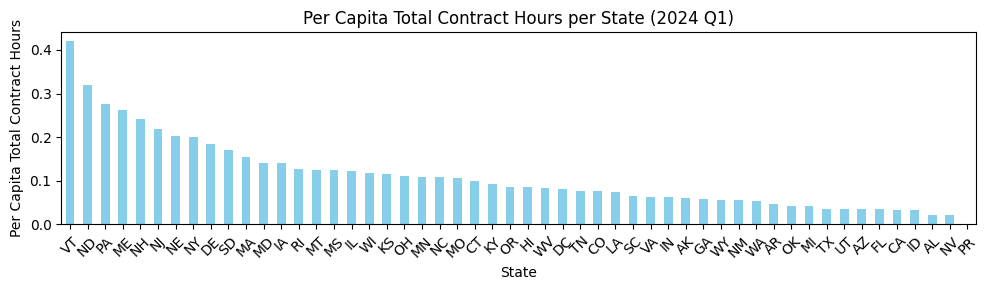

In [19]:
# Per Capita Total hours_ctr per State
percapita_total_hours_ctr_state = total_hours_ctr_state_df.groupby('STATE')['PerCapitaTotalHours_ctr'].sum().sort_values(ascending=False)

plt.figure(figsize=(10, 3))
percapita_total_hours_ctr_state.plot(kind='bar', color='skyblue')
plt.title('Per Capita Total Contract Hours per State (2024 Q1)')
plt.xlabel('State')
plt.ylabel('Per Capita Total Contract Hours')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [20]:
df1.head(3)

,PROVNUM,PROVNAME,CITY,STATE,COUNTY_NAME,COUNTY_FIPS,CY_Qtr,WorkDate,MDScensus,Hrs_RNDON,Hrs_RNDON_emp,Hrs_RNDON_ctr,Hrs_RNadmin,Hrs_RNadmin_emp,Hrs_RNadmin_ctr,Hrs_RN,Hrs_RN_emp,Hrs_RN_ctr,Hrs_LPNadmin,Hrs_LPNadmin_emp,Hrs_LPNadmin_ctr,Hrs_LPN,Hrs_LPN_emp,Hrs_LPN_ctr,Hrs_CNA,Hrs_CNA_emp,Hrs_CNA_ctr,Hrs_NAtrn,Hrs_NAtrn_emp,Hrs_NAtrn_ctr,Hrs_MedAide,Hrs_MedAide_emp,Hrs_MedAide_ctr,WorkDay,TotalHours,TotalHours_ctr,TotalHours_emp
0,15009,"BURNS NURSING HOME, INC.",RUSSELLVILLE,AL,Franklin,59,2024Q1,2024-01-01,50,8.0,8.0,0.0,8.00,8.00,0.0,40.07,40.07,0.0,0.0,0.0,0.0,18.16,18.16,0.0,156.34,156.34,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Monday,230.57,0.0,230.57
1,15009,"BURNS NURSING HOME, INC.",RUSSELLVILLE,AL,Franklin,59,2024Q1,2024-01-02,49,8.0,8.0,0.0,18.24,18.24,0.0,58.89,58.89,0.0,0.0,0.0,0.0,22.96,22.96,0.0,149.40,149.40,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Tuesday,257.49,0.0,257.49
2,15009,"BURNS NURSING HOME, INC.",RUSSELLVILLE,AL,Franklin,59,2024Q1,2024-01-03,49,8.0,8.0,0.0,15.10,15.10,0.0,55.02,55.02,0.0,0.0,0.0,0.0,20.70,20.70,0.0,147.15,147.15,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Wednesday,245.97,0.0,245.97


In [21]:
temp_df = df1[df1.loc[:,'PROVNUM']==15012]
(temp_df).head(2)

,PROVNUM,PROVNAME,CITY,STATE,COUNTY_NAME,COUNTY_FIPS,CY_Qtr,WorkDate,MDScensus,Hrs_RNDON,Hrs_RNDON_emp,Hrs_RNDON_ctr,Hrs_RNadmin,Hrs_RNadmin_emp,Hrs_RNadmin_ctr,Hrs_RN,Hrs_RN_emp,Hrs_RN_ctr,Hrs_LPNadmin,Hrs_LPNadmin_emp,Hrs_LPNadmin_ctr,Hrs_LPN,Hrs_LPN_emp,Hrs_LPN_ctr,Hrs_CNA,Hrs_CNA_emp,Hrs_CNA_ctr,Hrs_NAtrn,Hrs_NAtrn_emp,Hrs_NAtrn_ctr,Hrs_MedAide,Hrs_MedAide_emp,Hrs_MedAide_ctr,WorkDay,TotalHours,TotalHours_ctr,TotalHours_emp
182,15012,HIGHLANDS HEALTH AND REHAB,SCOTTSBORO,AL,Jackson,71,2024Q1,2024-01-01,42,4.0,4.0,0.0,4.15,4.15,0.0,15.99,15.99,0.0,0.0,0.0,0.0,21.32,21.32,0.0,106.76,106.76,0.0,13.04,13.04,0.0,0.0,0.0,0.0,Monday,165.26,0.0,165.26
183,15012,HIGHLANDS HEALTH AND REHAB,SCOTTSBORO,AL,Jackson,71,2024Q1,2024-01-02,43,8.0,8.0,0.0,8.65,8.65,0.0,42.07,42.07,0.0,0.0,0.0,0.0,12.45,12.45,0.0,129.76,129.76,0.0,8.82,8.82,0.0,0.0,0.0,0.0,Tuesday,209.75,0.0,209.75


In [22]:
# The reason, Hours columns with respect to resident can't work with PBJ PUF1 File/df1, is because data is potentially across more than 1 quarter in 
# Provider_Info_Aug2024 file/df2. but Location latitude,longitute certainly can be merged with PUF1 file/df1.
# temp_df.groupby('PROVNUM').agg({'Hrs_NAtrn':'mean'})   # 15.58 while from puf1 it shows 183, so tested that this assumption is consistent.   


In [23]:
file_path2 = open("C:\\Users\\darsh\\vscodeProjects\\vscodeProjectQuickTest\\CareFacilityStaffingInsights\\Data\\ProviderInfo_Aug2024_v2.csv")
df2 = pd.read_csv(file_path2)

In [24]:
df2.head(2)

,CMS Certification Number,Provider Name,Latitude,Longitude,Location,City/Town,State,Reported Nurse Aide Staffing Hours per Resident per Day,Reported LPN Staffing Hours per Resident per Day,Reported RN Staffing Hours per Resident per Day,Provider Address,ZIP Code,County/Parish,DateProvApproved,Average Number of Residents per Day,Processing Date
0,025020,DENALI CENTER,64.8304,-147.738,"1510 19TH AVENUE,FAIRBANKS,AK,99701",FAIRBANKS,AK,3.47897,0.78128,1.18108,1510 19TH AVENUE,99701,Fairbanks North Star,1983-11-01,69.2,8/1/2024
1,025028,CORDOVA COMMUNITY MED LTC,60.5416,-145.750,"602 CHASE AVE,CORDOVA,AK,99574",CORDOVA,AK,NaN,NaN,NaN,602 CHASE AVE,99574,Chugach,1994-03-22,9.8,8/1/2024


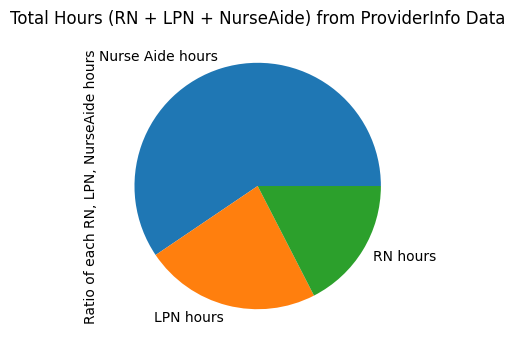

Nurse Aide hours    59.462260
LPN hours           23.095454
RN hours            17.442286
Name: Ratio of each RN, LPN, NurseAide hours, dtype: float64

In [25]:
df2.rename(columns={'Reported Nurse Aide Staffing Hours per Resident per Day':'Nurse Aide hours','Reported LPN Staffing Hours per Resident per Day':'LPN hours','Reported RN Staffing Hours per Resident per Day':'RN hours'},inplace=True)
s_agg_df2 = df2.agg({'Nurse Aide hours':'mean','LPN hours':'mean','RN hours':'mean'})


# Percentage Total hours_from df2
s_agg_df2_total = s_agg_df2.sum()
s_agg_df2_percent = ((s_agg_df2/s_agg_df2_total)*100)

# plt.figure(figsize=(10, 3))
# percent.plot(kind='bar', color='skyblue')
# plt.title('Percentage Total Contract Hours (2024 Q1)')
# plt.xlabel('State')
# plt.ylabel('Percentage Total Contract Hours')
# plt.xticks(rotation=45)
# plt.tight_layout()
# plt.show()

# make the plot
s_agg_df2_percent.name ='Ratio of each RN, LPN, NurseAide hours'
s_agg_df2_percent.sort_values(ascending=False,inplace=True)
s_agg_df2_percent.plot(kind='pie', subplots=True, figsize=(4,4))
plt.title('Total Hours (RN + LPN + NurseAide) from ProviderInfo Data')
# show the plot
plt.show()
# percent
s_agg_df2_percent.head()

In [26]:
# # Help
# set1 = set(df1['PROVNAME'].unique())
# set2 = set(df2['Provider Name'].unique())
# len(set1), len(set2)

In [27]:
# # Help
# len(set2.difference(set1))

In [28]:
# Help

# # df1['PROVNUM'].value_counts()
# # avg_total_ctr_hours_weekDate = df1.groupby('WorkDate')['TotalHours_ctr'].mean()
# # avg_total_ctr_hours_weekDate
# df1['PROVNUM'].value_counts(ascending=True)

,Average Contract Hours
CNA,12.974744
LPN,6.471522
RN,2.962977
RN_admin,0.243605
MedAide,0.222811
RN_director,0.093686
LPN_admin,0.076542
NurseAide,0.062373


,Average Contract Hours in Percentage
CNA,56.147646
LPN,28.005234
RN,12.822157
RN_admin,1.054191
MedAide,0.964204
RN_director,0.405420
LPN_admin,0.331234
NurseAide,0.269914


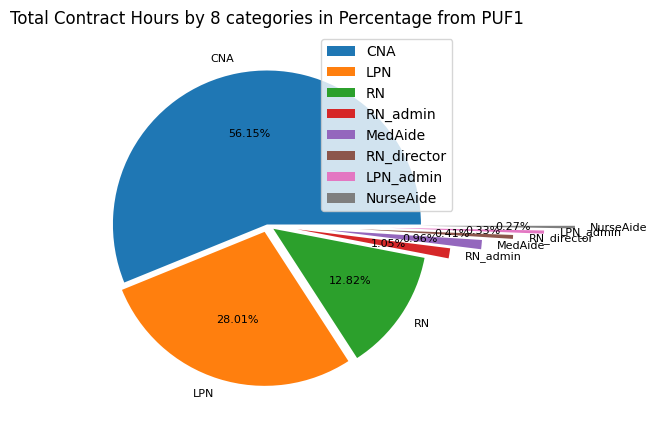

In [29]:
# print('Total Contract Hours by 8 categories per day average (in Hours):\n',df1.agg({'Hrs_RNDON_ctr':'mean','Hrs_RNadmin_ctr':'mean','Hrs_RN_ctr':'mean','Hrs_LPNadmin_ctr':'mean','Hrs_LPN_ctr':'mean','Hrs_CNA_ctr':'mean','Hrs_NAtrn_ctr':'mean','Hrs_MedAide_ctr':'mean'}))
s_temp6 = df1.agg({'Hrs_RNDON_ctr':'mean','Hrs_RNadmin_ctr':'mean','Hrs_RN_ctr':'mean','Hrs_LPNadmin_ctr':'mean','Hrs_LPN_ctr':'mean','Hrs_CNA_ctr':'mean','Hrs_NAtrn_ctr':'mean','Hrs_MedAide_ctr':'mean'})
temp6_df = pd.DataFrame(s_temp6.sort_values(ascending=False)).rename(columns={0:'Average Contract Hours'}, 
                             index={'Hrs_RNDON_ctr':'RN_director', 'Hrs_RNadmin_ctr':'RN_admin', 'Hrs_RN_ctr':'RN', 'Hrs_LPNadmin_ctr':'LPN_admin',
                                    'Hrs_LPN_ctr':'LPN', 'Hrs_CNA_ctr':'CNA', 'Hrs_NAtrn_ctr':'NurseAide', 'Hrs_MedAide_ctr':'MedAide'})
display(temp6_df)


s_agg1_df1 = df1.agg({'Hrs_RNDON_ctr':'mean','Hrs_RNadmin_ctr':'mean','Hrs_RN_ctr':'mean','Hrs_LPNadmin_ctr':'mean','Hrs_LPN_ctr':'mean','Hrs_CNA_ctr':'mean','Hrs_NAtrn_ctr':'mean','Hrs_MedAide_ctr':'mean'})

# Percentage Total contract hours_from PUF1/df1 by 8 Categories
s_agg1_df1_total = s_agg1_df1.sum()
s_agg1_df1_percent = ((s_agg1_df1/s_agg1_df1_total)*100)
s_agg1_df1 = s_agg1_df1_percent

s_agg1_df1_index = s_agg1_df1.index
agg1_df1 = pd.DataFrame(s_agg1_df1.to_numpy().reshape(8,1),index= s_agg1_df1_index).sort_values(0,ascending=False)
agg1_df1.rename(index={'Hrs_RNDON_ctr':'RN_director', 'Hrs_RNadmin_ctr':'RN_admin', 'Hrs_RN_ctr':'RN', 'Hrs_LPNadmin_ctr':'LPN_admin',
                       'Hrs_LPN_ctr':'LPN', 'Hrs_CNA_ctr':'CNA', 'Hrs_NAtrn_ctr':'NurseAide', 'Hrs_MedAide_ctr':'MedAide'},
                columns={0:'Average Contract Hours in Percentage'},inplace=True)

agg1_df1.plot.pie(y='Average Contract Hours in Percentage',
           autopct='%1.2f%%',
           ylabel='',
           fontsize= 8,
       #     explode=(0.4,0.2,0.2,0.1,0.1,0,0.8,0.6),
           explode=(0,0.05,0.05,0.2,0.4,0.6,0.8,1),
           figsize=(6,5),
           title='Total Contract Hours by 8 categories in Percentage from PUF1'
           )
agg1_df1

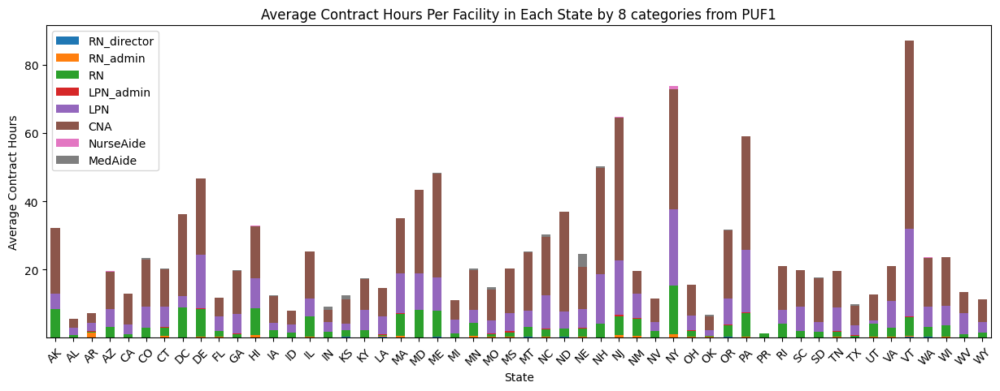

In [30]:
# Average Contract Hours per State by 8 categories (2024 Q1) from PUF1
temp1_df = df1.groupby('STATE').agg({'Hrs_RNDON_ctr':'mean','Hrs_RNadmin_ctr':'mean','Hrs_RN_ctr':'mean','Hrs_LPNadmin_ctr':'mean','Hrs_LPN_ctr':'mean','Hrs_CNA_ctr':'mean','Hrs_NAtrn_ctr':'mean','Hrs_MedAide_ctr':'mean'})
temp1_df.reset_index(inplace=True)
temp1_df.rename(columns={'Hrs_RNDON_ctr':'RN_director', 'Hrs_RNadmin_ctr':'RN_admin', 'Hrs_RN_ctr':'RN', 'Hrs_LPNadmin_ctr':'LPN_admin',
       'Hrs_LPN_ctr':'LPN', 'Hrs_CNA_ctr':'CNA', 'Hrs_NAtrn_ctr':'NurseAide', 'Hrs_MedAide_ctr':'MedAide'},inplace=True)


temp1_df.plot(x='STATE', kind='bar', stacked=True, title='Average Contract Hours Per Facility in Each State by 8 categories from PUF1', xlabel='State', ylabel='Average Contract Hours',figsize=(15,5))
plt.tick_params(axis='x', rotation=45)
plt.show()

Total Contract Hours by categories per day average (in Hours):
 Hrs_Total_RN_ctr      3.300268
Hrs_Total_LPN_ctr     6.548064
Hrs_CNA_ctr          12.974744
Hrs_NAtrn_ctr         0.062373
Hrs_MedAide_ctr       0.222811
dtype: float64


,Contract Hours in Percentage
CNA,56.147646
LPN_Total,28.336468
RN_Total,14.281767
MedAide,0.964204
NurseAide,0.269914


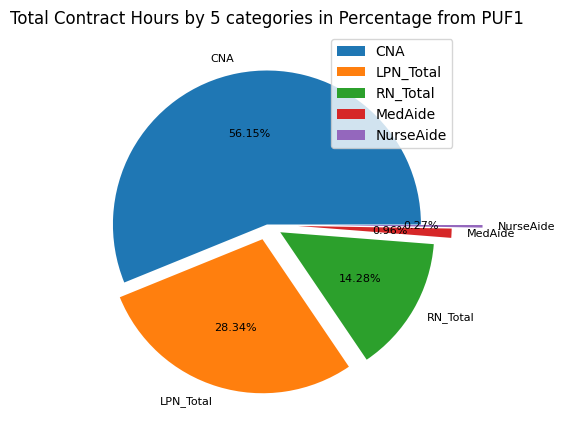

In [31]:
df1['Hrs_Total_RN_ctr'] = df1[['Hrs_RNDON_ctr', 'Hrs_RNadmin_ctr', 'Hrs_RN_ctr']].sum(axis=1)
df1['Hrs_Total_LPN_ctr'] = df1[['Hrs_LPNadmin_ctr', 'Hrs_LPN_ctr']].sum(axis=1)

temp2_df = df1.groupby('STATE').agg({'Hrs_Total_RN_ctr':'mean','Hrs_Total_LPN_ctr':'mean','Hrs_CNA_ctr':'mean','Hrs_NAtrn_ctr':'mean','Hrs_MedAide_ctr':'mean'}).head()

print('Total Contract Hours by categories per day average (in Hours):\n',df1.agg({'Hrs_Total_RN_ctr':'mean','Hrs_Total_LPN_ctr':'mean','Hrs_CNA_ctr':'mean','Hrs_NAtrn_ctr':'mean','Hrs_MedAide_ctr':'mean'}))

s_agg2_df1 = df1.agg({'Hrs_Total_RN_ctr':'mean','Hrs_Total_LPN_ctr':'mean','Hrs_CNA_ctr':'mean','Hrs_NAtrn_ctr':'mean','Hrs_MedAide_ctr':'mean'})


# Percentage Total contract hours_from PUF1/df1 by 5 Categories
s_agg2_df1_total = s_agg2_df1.sum()
s_agg2_df1_percent = ((s_agg2_df1/s_agg2_df1_total)*100)
s_agg2_df1 = s_agg2_df1_percent

s_agg2_df1_index = s_agg2_df1.index
agg2_df1 = pd.DataFrame(s_agg2_df1.to_numpy().reshape(5,1),index= s_agg2_df1_index).sort_values(0,ascending=False)
agg2_df1.rename(index={'Hrs_Total_RN_ctr':'RN_Total', 'Hrs_Total_LPN_ctr':'LPN_Total', 'Hrs_CNA_ctr':'CNA', 'Hrs_NAtrn_ctr':'NurseAide', 'Hrs_MedAide_ctr':'MedAide'},columns={0:'Contract Hours in Percentage'},inplace=True)

agg2_df1.plot.pie(y='Contract Hours in Percentage',
           autopct='%1.2f%%',
           ylabel='',
           fontsize= 8,
           explode=(0,0.1,0.1,0.2,0.4),
           figsize=(6,5),
           title='Total Contract Hours by 5 categories in Percentage from PUF1'
           )
agg2_df1.head()

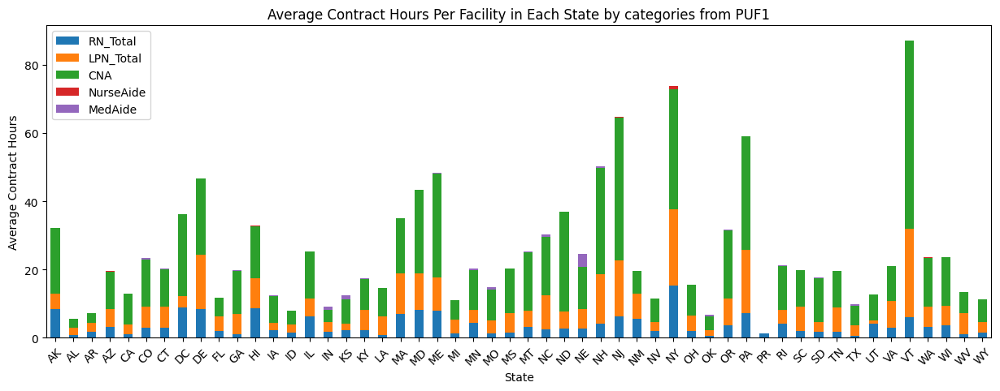

In [32]:
# Average Contract Hours per State by(2024 Q1) from PUF1
temp2_df = df1.groupby('STATE').agg({'Hrs_Total_RN_ctr':'mean','Hrs_Total_LPN_ctr':'mean','Hrs_CNA_ctr':'mean','Hrs_NAtrn_ctr':'mean','Hrs_MedAide_ctr':'mean'})
temp2_df.reset_index(inplace=True)
temp2_df.rename(columns={'Hrs_Total_RN_ctr':'RN_Total', 'Hrs_Total_LPN_ctr':'LPN_Total', 'Hrs_CNA_ctr':'CNA', 'Hrs_NAtrn_ctr':'NurseAide', 'Hrs_MedAide_ctr':'MedAide'},inplace=True)

temp2_df.plot(x='STATE', kind='bar', stacked=True, title='Average Contract Hours Per Facility in Each State by categories from PUF1', xlabel='State', ylabel='Average Contract Hours',figsize=(15,5))
plt.tick_params(axis='x', rotation=45)

In [33]:
# Using folium, plotting Total Average Hours per Provider on map
# Joining the tables/dataframes
temp3_df = df1.groupby('PROVNAME').agg({'TotalHours_ctr':'mean'}).reset_index()
temp4_df = pd.merge(left=temp3_df, right=df2, how= 'inner', left_on='PROVNAME',right_on='Provider Name')
temp4_df.head(1)
temp4_df.drop(columns=['Location', 'City/Town', 'Nurse Aide hours', 'LPN hours', 'RN hours', 
                        'Provider Address', 'ZIP Code', 'County/Parish', 'DateProvApproved',
                        'Average Number of Residents per Day', 'Processing Date'], inplace=True)

# Scalling the intensity of bubble in log scale, so map is viewable otherwise bigger radius bubble overshadows everything
temp4_df['TotalHours_ctr_scaled'] = np.log1p (temp4_df['TotalHours_ctr'])  
 
temp4_df = temp4_df[temp4_df['TotalHours_ctr']>0]           # considering those Providers for map, which have more than 0 cotract hours

In [34]:
temp4_df.head(2)

,PROVNAME,TotalHours_ctr,CMS Certification Number,Provider Name,Latitude,Longitude,State,TotalHours_ctr_scaled
2,60 WEST,15.596813,075442,60 WEST,41.6542,-72.643,CT,2.809211
4,A HOLLY PATTERSON EXTENDED CARE FACILITY,109.395604,335023,A HOLLY PATTERSON EXTENDED CARE FACILITY,40.6963,-73.584,NY,4.704070


In [35]:
import folium
from IPython.display import display
import branca.colormap as cm

# Create a map centered on the mean latitude and longitude
center_lat = temp4_df['Latitude'].mean()
center_lon = temp4_df['Longitude'].mean()
map = folium.Map(location=[center_lat, center_lon], zoom_start=5)

# Create a colormap
colormap = cm.LinearColormap(colors=["yellow", "orange", "black"], vmin=temp4_df['TotalHours_ctr_scaled'].min(), vmax=temp4_df['TotalHours_ctr_scaled'].max())
map.add_child(colormap)

# Add bubbles for each location
for idx, row in temp4_df.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=row['TotalHours_ctr_scaled'],
        popup=row['PROVNAME'],
        tooltip=f"Provider Name: {row['PROVNAME']}<br>Average Contract Hours: {row['TotalHours_ctr']}",
        color='#3186cc',
        fill_opacity=0.6,
        # opacity = 1,
        fill_color=colormap(row['TotalHours_ctr_scaled']),
        stroke= False,
        fill=True,
        # fill_color='#3186cc',
        
    ).add_to(map)

# # Save the map
map.save('Total Average Hours per Provider on Folium Map.html')

# Display the map in the notebook
display(map)


In [36]:
temp5_df = df1.groupby('STATE').agg({'TotalHours_ctr':'mean'}).reset_index()

#List of states and assigning us-code to each state
state2abbrevdict = {
        'Alaska': 'AK',  'Alabama': 'AL', 'Arkansas': 'AR',  'Arizona': 'AZ',   'California': 'CA', 'Colorado': 'CO',
        'Connecticut': 'CT','District of Columbia': 'DC',    'Delaware': 'DE',   'Florida': 'FL',   'Georgia': 'GA',
        'Hawaii': 'HI',        'Iowa': 'IA', 'Idaho': 'ID',        'Illinois': 'IL',    'Indiana': 'IN', 'Kansas': 'KS',
        'Kentucky': 'KY',  'Louisiana': 'LA',   'Massachusetts': 'MA',    'Maryland': 'MD',  'Maine': 'ME',  'Michigan': 'MI',
        'Minnesota': 'MN','Missouri': 'MO',   'Mississippi': 'MS',  'Montana': 'MT',        'North Carolina': 'NC',
        'North Dakota': 'ND',  'Nebraska': 'NE',   'New Hampshire': 'NH',    'New Jersey': 'NJ',  'New Mexico': 'NM',
        'Nevada': 'NV', 'New York': 'NY',  'Ohio': 'OH',    'Oklahoma': 'OK',   'Oregon': 'OR',   'Pennsylvania': 'PA',
        'Rhode Island': 'RI',   'South Carolina': 'SC',      'South Dakota': 'SD',    'Tennessee': 'TN',  'Texas': 'TX',
        'Utah': 'UT',   'Virginia': 'VA',   'Vermont': 'VT',    'Washington': 'WA',   'Wisconsin': 'WI',
        'West Virginia': 'WV',   'Wyoming': 'WY',   'Puerto Rico': 'PR',
    }
state2abbrev =pd.DataFrame.from_dict(state2abbrevdict,orient='index').reset_index()
temp5_df = pd.merge(left=temp5_df,right=state2abbrev, how='inner',left_on='STATE',right_on=0)
temp5_df = temp5_df.drop(columns=[0]).rename(columns={'index':'State','STATE':'StateCode'})
temp5_df.head(2)

,StateCode,TotalHours_ctr,State
0,AK,32.263495,Alaska
1,AL,5.496210,Alabama


In [37]:
display(pd.DataFrame(temp5_df).set_index('State').sort_values('TotalHours_ctr', ascending=False).rename(columns={'TotalHours_ctr':'Average Contract Hours Per Facility by State'}).head(10).drop(columns='StateCode'))
display(pd.DataFrame(total_hours_ctr_state).sort_values('TotalHours_ctr', ascending=False).rename(columns={'TotalHours_ctr':'Total Contract Hours by State'}).head(20))

,Average Contract Hours Per Facility by State
State,
Vermont,87.169722
New York,73.859501
New Jersey,64.856851
Pennsylvania,59.121611
New Hampshire,50.153822
Maine,48.450530
Delaware,46.753488
Maryland,43.458055
North Dakota,37.027202


,Total Contract Hours by State
STATE,
NY,4039449.99
PA,3577744.31
NJ,2036180.84
IL,1557327.83
CA,1346552.77
OH,1304113.78
NC,1126111.32
MA,1090336.45
TX,1037825.88


In [38]:
import folium
import pandas as pd
import geopandas as gpd

# GeoJSON file, downloaded from : https://eric.clst.org/tech/usgeojson/
geo_data = 'C:\\Users\\darsh\\vscodeProjects\\vscodeProjectQuickTest\\CareFacilityStaffingInsights\\Data\\us-states.json' 

# Read GeoJSON file
gdf = gpd.read_file(geo_data)

# Create map
m = folium.Map(location=[37.8, -96], zoom_start=4)

# Merge GeoDataFrame with population data
gdf = pd.merge(left=gdf, right=temp5_df, left_on='NAME', right_on='State', how='left')

# Add choropleth layer
folium.Choropleth(
    geo_data=geo_data,
    name='choropleth',
    data=temp5_df,
    columns=['State', 'TotalHours_ctr'],
    key_on='feature.properties.NAME',
    fill_color='YlOrRd',
    fill_opacity=0.75,
    line_opacity=0.2,
    legend_name='Average Contract Hours daily per facility by state'
).add_to(m)

# Add hover functionality
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.01, 
                                'weight': 0.4}

# Add GeoJson layer with tooltip
folium.GeoJson(
    gdf,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['State', 'TotalHours_ctr'],
        aliases=['State: ', 'Average Contract Hours daily per facility by state : '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;"),
        localize=True,
        sticky=False
    )
).add_to(m)

# Save map
m.save('US Average Contract Hours daily per facility by state.html')
display(m)